In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.optimize as sc

In [2]:
def fix_plot(ax):
    ax.tick_params(which="minor", direction="in", length=3, width=1.3,)
    ax.tick_params(which="major", direction="in", length=6, width=1.3)
    ax.tick_params(which="minor", direction="in", length=3, width=1.3,)
    ax.tick_params(which="major", direction="in", length=6, width=1.3)
    plt.setp(ax.spines.values(), linewidth=1.3)
    plt.setp(ax.spines.values(), linewidth=1.3)

## Monte Carlo Optimization

We are going to optimize the following potential in one dimension:

In [3]:
k_B = 8.617e-5 # eV/K
def V(x):
    return (-1.0  -np.exp(-((x+15.0)/10.0)*((x+15.0)/10.0)) \
              -2.0*np.exp(-((x-10.0)/10.0)*((x-10.0)/10.0)) + \
                -np.exp(-((x-35.0)/10.0)*((x-35.0)/10.0)) \
              -3.0*np.exp(-((x-60.0)/10.0)*((x-60.0)/10.0)) \
                -np.exp(-((x-85.0)/10.0)*((x-85.0)/10.0))\
              -2.0*np.exp(-((x-110.0)/10.0)*((x-110.0)/10.0)) \
              ) * \
            (1.0+1.0/5.0*np.cos(2.0*np.pi/2.5*x))

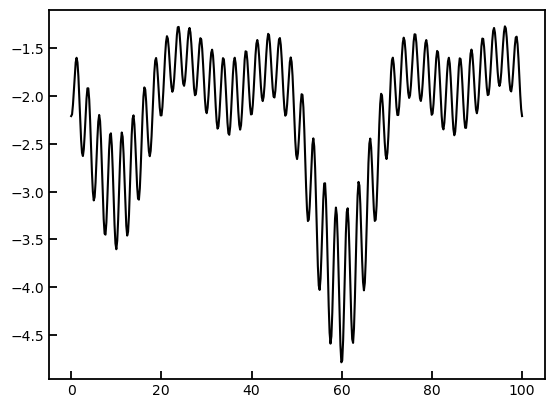

In [4]:
fig, ax = plt.subplots()
fix_plot(ax)
ax.plot(np.linspace(-0, 100, 500), V(np.linspace(0, 100, 500)), 'k')

We copy the Metropolis Monte Carlo Sampling class from previous exercises. It will be slightly modified to replace the uniform distribution sampling with a random walk (so that a random step from the current position is taken, rather than a random position from a fixed interval (but still drawing the step from a uniform distribution as opposed to a normal distribution)

In [5]:

import time
class Metropolis_Monte():
    def __init__(self, N, x0, xmin=-10, xmax=10, rmax=15):
        self._xmin = xmin
        self._xmax = xmax
        self._rmax = rmax
        self._no_of_samples = N
        self._x = x0
        if isinstance(x0, float) == False and isinstance(x0, int) == False:
            self._multi_D = True

    def acceptance(self, V, T, x, x_prime):
        if isinstance(x, (list, tuple, np.ndarray)):
            if np.linalg.norm(x) > self._rmax:
                return False
            prob = np.exp(- (V(x_prime) - V(x))/(k_B*T))
            number = np.random.rand()
            if number <= prob:
                return True
            return False

        if x_prime < self._xmin or x_prime > self._xmax:
            return False
        prob = np.exp(- (V(x_prime) - V(x))/(k_B*T))
        number = np.random.rand()
        if number <= prob:
            return True
        return False

    def sample_xi(self, x, Delta, uniform):
        if isinstance(x, (list, tuple, np.ndarray)):
            xis = np.array([])
            for this_x in x:
                xi = self.sample_xi(this_x, Delta=Delta, uniform=uniform)
                xis = np.append(xis, xi)
            return xis

        if uniform:
            dx = np.random.rand()*(2*Delta) - Delta
            xi = x + dx
            return xi
        else:
            dx = (np.random.normal())*Delta
            xi = x + dx
        return xi

    def run(self, V, T, Delta=0.1, uniform=False):
        if isinstance(self._x, (list, tuple, np.ndarray)):
            xis = np.zeros(shape=(self._no_of_samples, len(self._x)))
            xis[0, :] = self._x
        else:
            xis = np.zeros(shape=(self._no_of_samples))
            xis[0] = self._x
        for i in range(self._no_of_samples-1):
            xi = self.sample_xi(self._x, Delta=Delta, uniform=uniform)
            while not self.acceptance(V, T, self._x, xi):
                xi = self.sample_xi(self._x, Delta=Delta, uniform=uniform)
            if isinstance(self._x, (list, tuple, np.ndarray)):
                xis[i+1, :] = xi
            else:
                xis[i+1] = xi
            self._x = xi


        res = None

        return res, xis

4.0 5.254431518259928
4.0 8.562945983132531


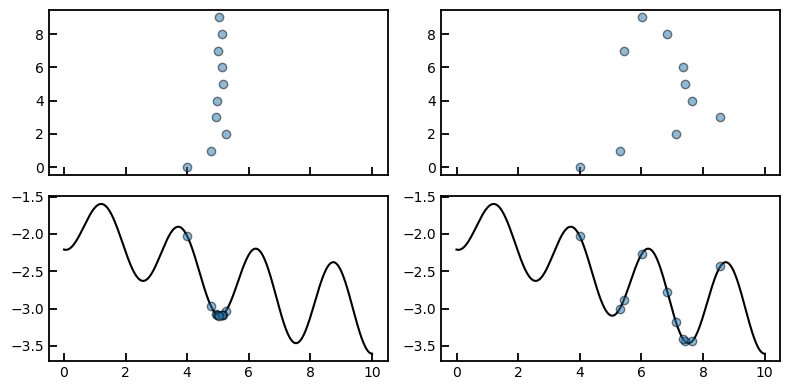

In [6]:
fig, ax = plt.subplots(2, 2, figsize=(8, 4), sharex=True)
for T, aks in zip([1e-2/k_B, 1e2/k_B], [0, 1]):
    metro = Metropolis_Monte(10, 4, xmin=0, xmax=100)
    xs = metro.run(V=V, T=T, Delta=2, uniform=True)[1]
    ax[1][aks].plot(np.linspace(0, 10, 500), V(np.linspace(0, 10, 500)), "k")
    ax[0][aks].plot(xs, range(len(xs)), "o", markeredgecolor='k', alpha=0.5)
    print(min(xs), max(xs))
    fix_plot(ax[0][aks])
    fix_plot(ax[1][aks])
    ax[1][aks].plot(xs, V(xs), "o", markeredgecolor='k', alpha=0.5)
    fig.tight_layout()

### Animation of walking in the potential

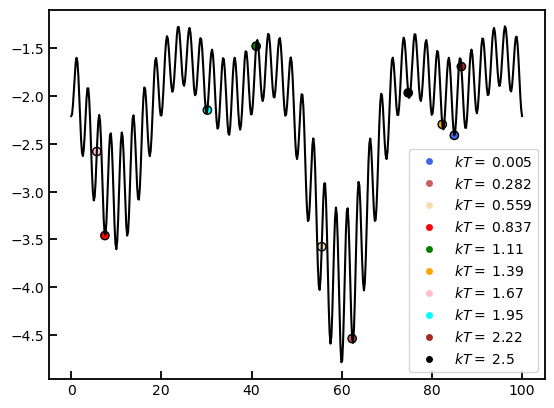

In [7]:
from matplotlib import animation
N = 300
fig, ax = plt.subplots()
fix_plot(ax)
plt.rc('animation', html='jshtml')
ax.plot(np.linspace(0, 100, 500), V(np.linspace(0, 100, 500)), "k")

no_of_Temps = 10
colors = ['royalblue', 'indianred', 'wheat', 'red', 'green', 'orange', 'pink', 'cyan', 'brown', 'k']

Ts = np.linspace(0.005/k_B, 2.5/k_B, no_of_Temps)
x0s = [np.random.rand()*80 + 20 for i in range(no_of_Temps)]
data = np.zeros(shape=(no_of_Temps, N))
for j in range(no_of_Temps):
    m = Metropolis_Monte(N, x0s[j], xmin=0, xmax=100)
    data[j, :] = m.run(V=V, T=Ts[j], Delta=2, uniform=False)[1]

walker = ax.scatter(data[:,0], V(data[:,0]), color=colors, edgecolor='k', alpha=1)
def update(i):
    arr = np.zeros(shape=(no_of_Temps, 2))
    arr[:, 0] = data[:, i]
    arr[:, 1] = V(data[:, i])
    #walker = ax.scatter(data[:,i], V(data[:,i]), color=colors, edgecolor='k', alpha=1)
    walker.set_offsets(arr)
    return [walker]

from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], marker="o", markerfacecolor=colors[i], color='w') for i in range(len(colors))]
ax.legend(custom_lines, [f"$kT =$ {Ts[i]*k_B:.3}" for i in range(no_of_Temps)])

anim = animation.FuncAnimation(fig, update, frames=N, interval=100, blit=True)
anim

In [8]:
N_walker = 800
N_steps = 4000
no_of_Temps = 5
Ts = np.linspace(0.1/k_B, 1/k_B, no_of_Temps)
N_required = np.zeros(shape=(no_of_Temps, N_walker))
for t in range(no_of_Temps):
    for i in range(N_walker):
        m = Metropolis_Monte(N_steps, np.random.rand()*(100), xmin=-50, xmax=150)
        sample = m.run(V=V, T=Ts[t], Delta=2, uniform=True)[1]
        success = False
        for j in range(len(sample)):
            if V(sample[j]) <= -4.75:
                N_required[t, i] = j
                Success = True
                break
            if success == False:
                N_required[t, i] = None

KeyboardInterrupt: 

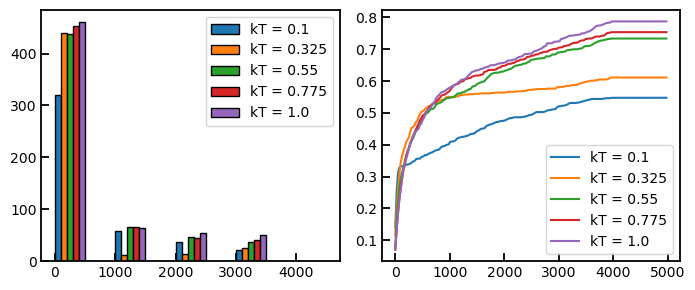

In [53]:
hists = []
hists2 = []

for t in range(no_of_Temps):
    height, bins = np.histogram([q for q in N_required[t, :] if not np.isnan(q)], bins=[0, 1000, 2000, 3000, 4000, 5000])
    hists.append([height, bins])
    height, bins = np.histogram([q for q in N_required[t, :] if not np.isnan(q)], bins=np.linspace(0, 5000, 200))
    hists2.append([height, bins])

for j in range(len(hists2)):
    hists2[j][0] = np.array([sum(hists2[j][0][0:i+1])/N_walker for i in range(len(hists2[j][0]))])
fig, ax = plt.subplots(1, 2, figsize=(7, 3))
for i in range(no_of_Temps):
    ax[0].bar(np.array(hists[i][1][:-1])+100*i, hists[i][0], align='edge', width=100, label=f"kT = {Ts[i]*k_B:.3}", edgecolor='k')
    ax[1].plot(hists2[i][1][:-1], hists2[i][0], label=f"kT = {Ts[i]*k_B:.3}")
for s in [0, 1]:
    fix_plot(ax[s])
    ax[s].legend()
fig.tight_layout()

### Discussion / Interpretation

The general trend is that low temperatures hit roughly as many within the first ~ 500 iterations. However, at larger numbers of iterations, the lower temperatures stop succeeding. The cause may be that, if a low temperature walker has not hit the global minimum within a few iterations, it is likely because it is stuck in a local minimum, which it will continue to be for the remainder of the iterations.

There is one large discrepancy to this trend, which is for kT = 0.1. I do not know what causes this. I did, however, notice that even lower temperatures are not possible at all due to some calculation errors. There may be some rounding error causing these issues as well as this discrepancy.

## Lennard-Jones Potential

In [9]:
from scipy.spatial.distance import pdist
class LennardJones():
    def __init__(self,eps0=5,sigma=2**(-1/6)):
        self.eps0 = eps0
        self.sigma = sigma
        
    def _V(self,r):
        return 4*self.eps0*((self.sigma/r)**12 - (self.sigma/r)**6)

    def energy(self, pos): #pos must have shape MxN, where M is the number of particles, and N is the dimension of the space which they occupy
        return np.sum(self._V(pdist(pos)))



In [10]:
def pot_plot(positions, ax):
    ax.plot(positions[:, 0], positions[:, 1], "o", markersize=50, markeredgecolor='k', color='royalblue')
    fix_plot(ax)
    ax.set_xlim(-2, 2)
    ax.set_ylim(-1, 3)
    ax.set_yticks([-1, 0, 1, 2, 3])
    ax.set_xticks([-2, -1, 0, 1, 2])
    ax.grid()

    #Calculate energy:
    lj = LennardJones()
    e = lj.energy(positions)
    ax.set_title(f"$E =$ {e:.5}")

### Atomic clusters

The right one is corresponding to one in the lecture notes, while the left one is the one used in further calculations

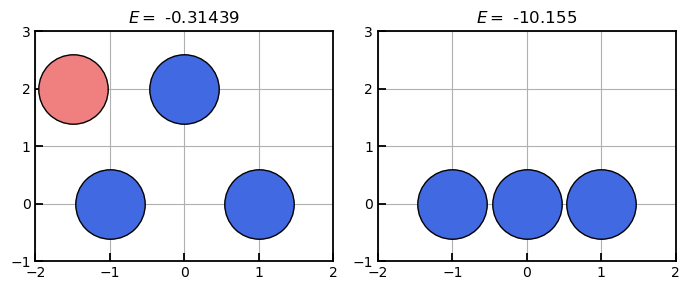

In [11]:
fig, ax = plt.subplots(1, 2, figsize=(7, 3))

pos1 = np.array([[0, 2], [-1, 0], [1, 0]])
pos2 = np.array([[-1, 0], [0, 0], [1, 0]])
pot_plot(pos1, ax[0])
pot_plot(pos2, ax[1])
ax[0].plot(-1.5, 2, "o", markeredgecolor='k', color="lightcoral", markersize=50)


fig.tight_layout()

### 2D Restricted Potential Landscape

I will use the potential with respect to the coordinates of a fourth atom in the potential of the three atoms on the left plot above. (the red atom is allowed to move)

In [12]:
def restricted_V(coor): #coor is assumed to be a 1*2 array
    pos = np.array([[coor[0], coor[1]], [-0.95, 0], [0.95, 0], [0, 1.7]])
    lj = LennardJones()
    return lj.energy(pos)

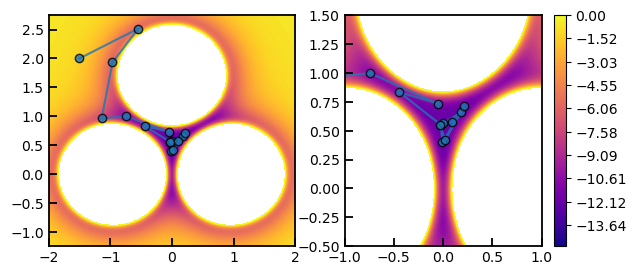

In [13]:
def plot_cont(ax, xlim, ylim, colorbar=False):
    fix_plot(ax)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    reso = 100
    x = np.linspace(xlim[0], xlim[1], reso)
    y = np.linspace(ylim[0], ylim[1], reso)

    X, Y = np.meshgrid(x, y)
    Z = np.zeros(shape=(len(x), len(y)))
    for i in range(len(y)):
        for j in range(len(x)):
            Z[i, j] = restricted_V([x[j], y[i]])

    con = ax.contourf(x, y, Z, cmap='plasma', levels=np.linspace(-15, 0, reso))

    if colorbar:
        fig.colorbar(con)

fig, ax = plt.subplots(1, 2, figsize=(7, 3))

plot_cont(ax[0], (-2, 2), (-1.25, 2.75))
plot_cont(ax[1], (-1, 1), (-0.5, 1.5), colorbar=True)

mont = Metropolis_Monte(15, np.array([-1.5, 2]))
xs = mont.run(restricted_V, 0.1/k_B, Delta=1, uniform=True)[1]
ax[0].plot(xs[:, 0], xs[:, 1], "o-", markeredgecolor='k', alpha=0.8)
ax[1].plot(xs[:, 0], xs[:, 1], "o-", markeredgecolor='k', alpha=0.8)

### Atomic Cluster Simulations with Metropolis Monte Carlo Optimization

In [14]:
def V_cluster(coor): #coor is assumed to be a 1*2N array
    pos = [[0, 0]]
    for i in range(int(len(coor)/2)):
        pos.append([coor[i*2], coor[i*2+1]])
    lj = LennardJones()
    return lj.energy(np.array(pos))

In [15]:
mont = Metropolis_Monte(100000, np.array([-3, 2.5, -1.2, -3, 0.5, -0.5, 2.6, 0.7, 3.5, -2.5]), rmax=1000)
xs = mont.run(V_cluster, 1/k_B, Delta=0.1, uniform=True)[1]

KeyboardInterrupt: 

In [12]:
mont2 = Metropolis_Monte(100000, np.array([-3, 2.5, -1.2, -3, 0.5, -0.5, 2.6, 0.7, 3.5, -2.5, 1, 3]), rmax=1000)
xs2 = mont2.run(V_cluster, 1/k_B, Delta=0.1, uniform=True)[1]

Animation size has reached 20995264 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


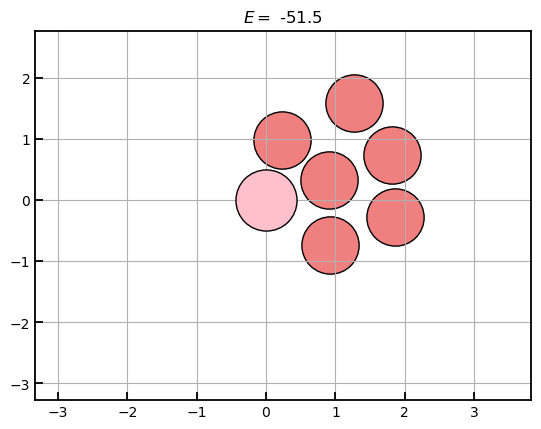

In [30]:

from matplotlib import animation
fig, ax = plt.subplots()
fix_plot(ax)
ax.grid()
plt.rc('animation', html='jshtml')

no_of_atoms = int(len(mont2._x)/2)

ax.plot(0, 0, "o", markersize=44, color="pink", markeredgecolor='k')
walker = ax.scatter([xs2[0][i*2] for i in range(int(len(xs[0])/2))], [xs2[0][i*2 + 1] for i in range(int(len(xs[0])/2))], color="lightcoral", edgecolor='k', alpha=1, s=1700)

def update(i):
    arr = np.zeros(shape=(no_of_atoms, 2))
    for ii in range(no_of_atoms):
        arr[ii][0] = xs2[30*i][ii*2]
        arr[ii][1] = xs2[30*i][ii*2+1]
        ax.set_title(f"$E =$ {V_cluster(xs2[30*i]):.3}")
    walker.set_offsets(arr)
    return [walker]

anim = animation.FuncAnimation(fig, update, frames=1000, interval=50, blit=True)
anim


## Line Search

In [16]:
class LineSearch():
    def __init__(self, eps=1e-3, max_steps=10000):
        self._eps = eps
        self._max_steps = max_steps
    

### Lennard-Jones, continued

We can write a new class which is just the added methods for force calculations, by creating a subclass of the old class. Calculating forces allow us to do Line Search Optimization

In [69]:
class LennardJones_Update(LennardJones):
    def __init__(self,eps0=5,sigma=2**(-1/6)):
        super().__init__(eps0=eps0, sigma=sigma)
        self._atoms_data = []


    def _dV_dr(self, r):
        return 4*self.eps0*(-12*(self.sigma**12/r**13) + 6*(self.sigma**6/r**7))

    def forces(self, pos):
        diff = pos[np.newaxis, :, :] - pos[:, np.newaxis, :]
        r = np.sqrt(np.sum(diff**2, axis=-1))
        np.fill_diagonal(r, np.inf)
        force_magnitude = self._dV_dr(r)
        forces = np.sum(force_magnitude[..., np.newaxis] * diff / \
                        r[..., np.newaxis], axis=1)
        return forces
    
    def lineSearch(self, pos, no_of_free_atoms, eps=1e-3, max_steps=200, step_number=0):
        self._atoms_data.append(pos)
        if step_number >= max_steps:
            print("Done! Maximum number of iterations reached in Line Search")
            return np.array(self._atoms_data)
        
        #Find direction of gradient
        forces = self.forces(pos)
        #It is assumed that the coordinates of the free atoms are last - Forces on "static" atoms are set to 0
        forces[0:-no_of_free_atoms, :] = 0

        #Size of force
        force_magnitude = np.linalg.norm(forces)
        if force_magnitude < eps:
            print("Done! Desired accuracy reached in Line Search")
            return np.array(self._atoms_data)
        
        direction = forces/force_magnitude

        def new_E(alpha):
            new_pos = np.add(pos, alpha*direction)
            return self.energy(new_pos)
        
        new_pos = np.add(pos, (sc.minimize(new_E, 0.1).x)*direction)
        return self.lineSearch(new_pos, eps=eps, max_steps=max_steps, step_number=step_number+1, no_of_free_atoms=no_of_free_atoms)

        

Done! Desired accuracy reached in Line Search


/var/folders/hx/0yg2wcqs2gj6t85dcg16np8m0000gn/T/ipykernel_39701/999224688.py:18: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(con)


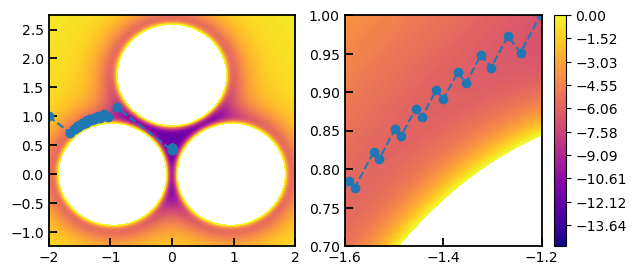

In [80]:
fig, ax = plt.subplots(1, 2, figsize=(7, 3))
lennard = LennardJones_Update()
l = lennard.lineSearch(np.array([[-0.95, 0], [0.95, 0], [0, 1.7], [-2, 1]]), no_of_free_atoms=1, eps=1e-2)

plot_cont(ax[0], (-2, 2), (-1.25, 2.75), colorbar=True)
plot_cont(ax[1], (-1.6, -1.2), (0.7, 1))

ax[0].plot(l[:, -1, 0], l[:, -1, 1], "--o")
ax[1].plot(l[:, -1, 0], l[:, -1, 1], "--o")


### Interpretation:

Relaxation path / local optimization path is zig-zaggy -> This is due to the nature of Line Search. Instead of taking a small step in the direction of the gradient (as gradient descent), one optimization direction is exhausted along the direction of the current gradient. This would ensure that the gradient after this relaxation step is perpendicular to the old gradient, since one step is optimized fully in one direction, i.e., until the derivative in this direction is 0. Hence, the updated gradient has no component in that direction. This results in the zig-zaggy pattern